In [1]:
import pandas as pd
import numpy as np
import seaborn as sb
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.cluster import KMeans
from sklearn.neighbors import LocalOutlierFactor
from sklearn.preprocessing import StandardScaler
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.arima.model import ARIMA
from IPython.display import clear_output

plt.style.use('ggplot')

In [3]:
df = pd.read_csv("SWaT_train.csv")
df_test = pd.read_csv("SWaT_test.csv", skipinitialspace=True)
# converting Timestamp to datetime so as to manipulate it easier.
df[' Timestamp'] = pd.to_datetime(df[' Timestamp'])
# set time as index
df.set_index([' Timestamp'], drop=True, inplace=True)

In [ ]:
df.head()

,FIT101,LIT101,MV101,P101,P102,AIT201,AIT202,AIT203,FIT201,MV201,P201,P202,P203,P204,P205,P206,DPIT301,FIT301,LIT301,MV301,MV302,MV303,MV304,P301,P302,AIT401,AIT402,FIT401,LIT401,P401,P402,P403,P404,UV401,AIT501,AIT502,AIT503,AIT504,FIT501,FIT502,FIT503,FIT504,P501,P502,PIT501,PIT502,PIT503,FIT601,P601,P602,P603,Normal/Attack
Timestamp,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2015-12-22 16:00:00,2.470294,261.5804,2,2,1,244.3284,8.19008,306.101,2.471278,2,1,1,2,1,2,1,20.79839,2.235275,327.4401,1,2,1,1,2,1,0.0,171.0587,0.0,238.0544,1,1,1,1,1,7.308575,176.8265,263.6504,12.68905,0.001666,0.001409,0.001664,0.0,1,1,10.02948,0.0,4.277749,0.000256,1,1,1,Normal
2015-12-22 16:00:01,2.457163,261.1879,2,2,1,244.3284,8.19008,306.101,2.468587,2,1,1,2,1,2,1,20.79839,2.234507,327.4401,1,2,1,1,2,1,0.0,171.0587,0.0,238.1312,1,1,1,1,1,7.308575,176.8008,263.6504,12.68905,0.001666,0.001409,0.001664,0.0,1,1,10.02948,0.0,4.277749,0.000256,1,1,1,Normal
2015-12-22 16:00:02,2.439548,260.9131,2,2,1,244.3284,8.19008,306.101,2.467305,2,1,1,2,1,2,1,20.84320,2.233354,327.4401,1,2,1,1,2,1,0.0,171.0587,0.0,238.0544,1,1,1,1,1,7.308575,176.8008,263.6504,12.68905,0.001666,0.001409,0.001664,0.0,1,1,10.02948,0.0,4.277749,0.000256,1,1,1,Normal
2015-12-22 16:00:03,2.428338,260.2850,2,2,1,244.3284,8.19008,306.101,2.466536,2,1,1,2,1,2,1,20.84320,2.233354,327.2799,1,2,1,1,2,1,0.0,171.0587,0.0,238.2081,1,1,1,1,1,7.308575,176.8008,263.6504,12.68905,0.001666,0.001409,0.001664,0.0,1,1,10.02948,0.0,4.277749,0.000256,1,1,1,Normal
2015-12-22 16:00:04,2.424815,259.8925,2,2,1,244.4245,8.19008,306.101,2.466536,2,1,1,2,1,2,1,20.84320,2.233354,327.1597,1,2,1,1,2,1,0.0,171.0587,0.0,238.4389,1,1,1,1,1,7.308575,176.8008,263.6504,12.68905,0.001666,0.001409,0.001664,0.0,1,1,10.02948,0.0,4.277749,0.000256,1,1,1,Normal


In [ ]:
# take the average of 4 seconds time period data points to combine them. 25% of the initial adata set
subset_ = df.resample("4S").mean()
subset_ = StandardScaler().fit_transform(subset_)

In [ ]:
distortions = []
K = range(1,15)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(subset_)
    distortions.append(kmeanModel.inertia_)

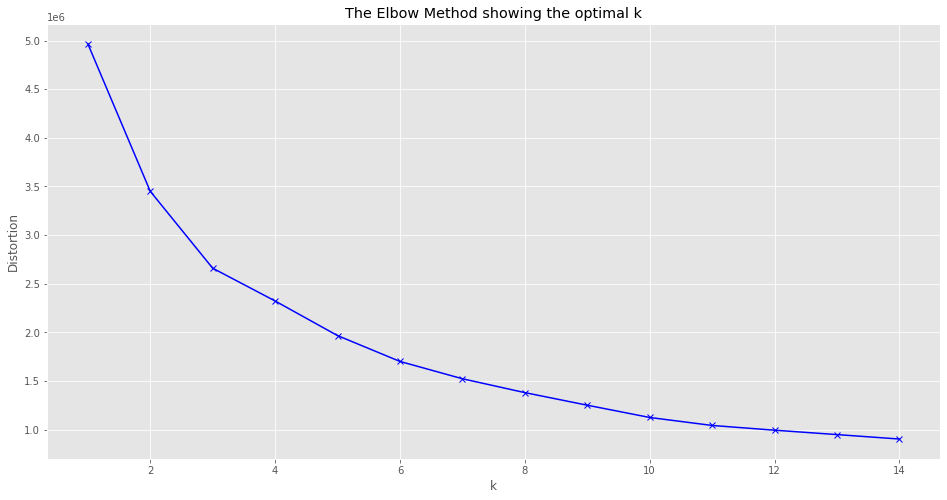

In [ ]:
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')

plt.title('The Elbow Method showing the optimal k')
plt.show()

In [ ]:
means_neighbors = []
for k in range(1, 11):
    clf = LocalOutlierFactor(n_neighbors = k, metric='minkowski')
    y_pred = clf.fit_predict(subset_)
    # append the LOF score mean so as to plot it.
    means_neighbors.append(np.mean(clf.negative_outlier_factor_))

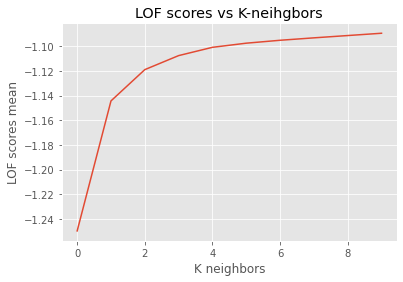

In [ ]:
plt.title('LOF scores vs K-neihgbors')
plt.ylabel('LOF scores mean')
plt.xlabel('K neighbors')
plt.plot(means_neighbors)

The number of the neighbors that I eventually tried is both k = 6 and k = 8. I applied the model in the whole data set instead of the 25%.
#Plot the LOF scores on the training data 1 as a signalfor several numbers of neighbors. Select a number to use and justify this choice using the obtained LOF scores and detected anomalies

In [ ]:
# fit the model for outlier detection (default)
# n_neighbors is the neighbors to consider when calculating LOF score for each point.
# Distance I've chosen is the minkowski, which is also the default.
clf = LocalOutlierFactor(n_neighbors=6, metric='minkowski')
# use the data and predict whether the points are outliers or inliners. If y_pred[i] == 1
# it is a inlier, if it's -1 it's outlier.
df_scaled = df.drop(columns=['Normal/Attack'])
df_scaled = StandardScaler().fit_transform(df_scaled)
y_pred = clf.fit_predict(df_scaled)

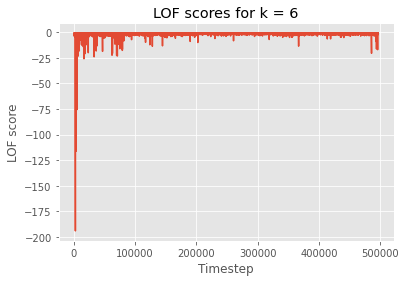

In [ ]:
plt.plot(clf.negative_outlier_factor_)
plt.title("LOF scores for k = 6")
plt.xlabel("Timestep")
plt.ylabel("LOF score")
plt.show()

In [ ]:
ratio_outliers = len(y_pred[y_pred==-1]) / len(y_pred)
ratio_outliers

0.025909822866344606

#Do you see large abnormalities in the training data? Can you explain why these occur? ? It is best to remove such abnormalities from the training data since you only want to model normal behavior.

Mostly detected abnormalities exist in the initilaziation since the system hasn't stabilized yet, approximately until 100000 timesteps (which is also evident by plotting the LOF scores for all the data points using k = 6). In addition, from the LOF plot we see that some outliers occur also in the end of the process which might be because of contexuality.

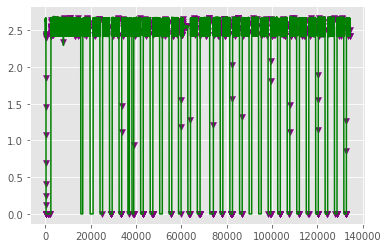

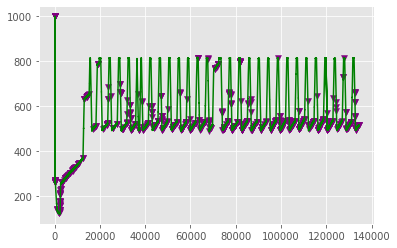

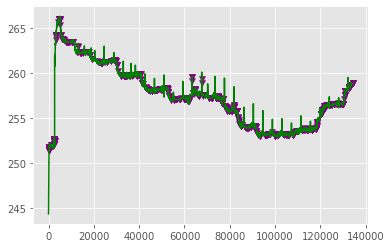

In [ ]:
"""
function to plot the outliers in a given signal.
input : df : the whole dataframe, y_pred : the predictions LOF returned (aka outliers),
    signal : which signal to print from the df, outliers_num : how many outliers to visualize.
output : priting the plot with the given signal and highlighting the outliers.
"""
def plot_outliers(df, y_pred, signal : str, outliers_num : int):
    # find the indeces of the outliers
    outliers = np.where(y_pred==-1)
    # plot only the outliers in the given range.
    plt.scatter(outliers[0][:outliers_num], df_scaled.loc[outliers[0][:outliers_num]][signal], c='purple', marker='v')
    # index of the last outlier.
    last_outlier_ind = df_scaled.loc[result[0][:outliers_num]].index[-1]
    plt.plot(df_scaled[signal][:last_outlier_ind], c='green')
    plt.show()

# plot 3 signals.
signals_to_plot = ["FIT101", "LIT101", "AIT201"]
for signal in signals_to_plot:
    plot_outliers(df, y_pred, signal, 750)


# What kind of anomalies can / can you not detect using LOF?

We have three different types of anomalies : point, contextual and collective.


With LOF you can detect point anomalies because it measures the local deviation of density of a given sample with respect to its neighbors. It is local in that the anomaly score depends on how apart the object is with respect to the surrounding neighborhood. The definition of the point anomaly is as follows : A data point that is anomalous since it deviates largely from the rest of the data points. In addition to that most of the times LOF won't be able to detect collective anomalies but this is really dependant on how many neighbors we consider when running the alogorithm, but in principal if we have a group of outliers that are neighbors they won't be classified as anomalies using LOF. Finally, LOF cannot detect contextual anomalies, since LOF finds the neighbors in the time series, so it doesn't have any "ordered" information for the time.

***ARMA MODEL***

In [ ]:
# METHODS FOR STATIONARITY AND ACF PLOTS.
"""
Plotting the acf and pcf respectively for a signal (series.)
input : series : the signal that we want to plot for
"""
def autocorrelation_plots(series,lags=50):
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize = (16, 8))
    plot_acf(series.values.squeeze(), lags=lags, ax=ax1)
    plot_pacf(series, lags=lags, ax=ax2)
"""
The ADF test is a statistical test with the following hypotheses

Null Hypothesis (H0): If failed to be rejected, it suggests the time series has a unit root, meaning it is non-stationary. 
It has some time dependent structure. 
Alternate Hypothesis (H1): The null hypothesis is rejected; it suggests the time series does not have a unit root, meaning it is stationary. 
It does not have time-dependent structure.
If ADF statistic is above a critical size, we cannot reject the null hypothesis, thus we accept. 
"""
def stationarity(df, signal : str):
    result = adfuller(df[signal][:150000])
    print("S_PU10")
    print('ADF Statistic: %f' % result[0])
    print('p-value: %f' % result[1])
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))
    print("---------------------")

"""
Function that does the check for stationarity and then plot the ACF, PACF.
"""
def Stationarity_ACF(signal):
    # testing whether the sensor has a stationarity property, meaning that it doesn't include 
    # any "weird" behavior because e.g. we have seasonal trends.
    stationarity(df, signal)
    # plot acf/pacf of the whole series
    series = df[signal]

    autocorrelation_plots(series, lags=50)
    plt.show()

In [ ]:
# METHODS TO DETERMINE THE ORDER WITH AIC.
'''
Helping function to determine the optimal order (p,q)
for the ARMA model to be fitted. The optimal order is found based on AIC; lowest
AIC means bettter fit.
Paremeters :  Time_series : time-series on which ARMA will be fitted,
        p, q: arrays of values to be examined for order AR and MA respectively.
Return : optimal_p, optimal_q: optimal order extracted,
        AIC: AIC values for each model tested (to evaluate),
        mean_resids, std_resids: mean values and standard deviations for the residuals
                                 from each model
'''
def find_best_combination(Time_series, p, q, diff):
    AIC_values = {}
    mean_resids = np.zeros((len(p), len(q)))
    std_resids = np.zeros((len(p), len(q)))
    for i, order_AR in enumerate(p):
        for j, order_MA in enumerate(q):
            try:
                print(f" order AR, order_MA : {order_AR, order_MA}")
                model = ARIMA(Time_series, order=(order_AR, diff, order_MA)).fit()
                AIC_values[order_AR, order_MA] = model.aic
                mean_resids[i,j] = np.mean(model.resid)
                std_resids[i,j] = np.std(model.resid)
            except:
                print(f"Cannot find a model with orders AR :{order_AR}, MA :{order_MA}")

    # sort AIC_Values by desceding order.
    AIC_values = dict(sorted(AIC_values.items(), key=lambda item: item[1]))
    # take the first item that is the minimum and assign p, q
    min = list(AIC_values.keys())[0]
    # take the optimals
    optimal_p, optimal_q = min[0], min[1]

    return optimal_p, optimal_q, AIC_values, mean_resids, std_resids

"""
Function to apply a grid search.
input : signal : signal that you want to apply grid search, upper_p : will be the upper bound of arma order, 
 upper_q : will be the upper bound of MA order, diff : differencing orders if the series aren't stationary.
 Return : prints the optimal orders to retrain on 
"""
def gridSearch(signal, upper_p, upper_q, diff):
    # Determine the value ranges of AR, MA order respectively.
    p = np.arange(0, upper_p + 1)
    q = np.arange(0, upper_q + 1)
    print(f" p {p} and q {q}")
    # ---------------------------------------------
    # DO a grid search based on the "optimal" orders given by autocorrelation plots.
    opt_p, opt_q, AIC, _, _ = find_best_combination(df[signal], p, q, diff)
    print(AIC)
    print(f" Optimal order_AR, order_MA : {opt_p, opt_q}")
    return opt_p, opt_q, AIC

In [ ]:
# METHODS FOR MODEL/RESIDUALS AND PREDICTION
"""
 Function that re-train with the optimal values and print the residuals plot, density plot of residuals and statstics.
 input : signal, optimal order AR, MA and differencinf if needed.
"""
def Model_Residuals(signal, opt_p, opt_q, differencing):
    # Re run the best obtained model to keep track of the residuals .
    model = ARIMA(df[signal].values, order=(opt_p, differencing, opt_q)).fit()
    # summary of fit model
    print(model.summary())
    # line plot of residuals
    residuals = pd.DataFrame(model.resid)
    # change the residuals to the absolute value because the sign doesn't matter.
    residuals = residuals.abs()
    residuals.plot()
    plt.show()
    return model, residuals

"""
To make the prediction we have to come up with a threshold that we deicde based on the residuals. In general, we know that
the higher the residual is, the more "anomaly" we can say it is.
pick a ratio, say 5% for now and the threshold will be the lowest one.
"""
def defineThreshold(residuals, ratio = 0.2):
    residuals_sorted = residuals.sort_values(by=0, ascending=False).reset_index(drop=True)
    # take the last value as threshold to consider it an outlier.
    threshold = float(residuals_sorted[:int(len(residuals_sorted) * ratio)].iloc[-1])
    print(f"threshold : {threshold}")
    return threshold

"""
input : model already trained in the training data, signal : signal to predict.
return : return the predicted model values, anomalies_indeces : return the indeces of the anomalies found.
"""
def predict(model, signal : str, threshold):
    # predictions numbers
    model_test = model.apply(df_test[signal])
    # take the residuals abs
    res_test = model_test.resid.abs()
    predicted_values = model_test.predict(0, len(df_test) - 1)
    # True if it's an outlier
    anomalies_prediction = res_test.abs().values > threshold
    # where the anomalies occur.
    anomalies_indeces = np.argwhere(anomalies_prediction==True)
    return predicted_values, anomalies_indeces

In [ ]:
# METHODS FOR PLOTTING ANOMALIES AND CONFUSION MATRIX.
"""
Function that plots the predicted vs ground truth anomalies in the test data.
input : signal, and predicted anomalies indeces.
returns the ground truth beacuse we need it for the confusion matrix.
"""
def plotAnomalies(signal, anomalies_indeces):
    plt.style.use('seaborn')
    plt.figure(figsize=(10, 5))
    limit = len(df_test)
    plt.plot(df_test[signal])
    # subset_anomalies till the limit.
    subset_anomalies = anomalies_indeces[anomalies_indeces < limit]
    # x axis put the data points of the test where 
    ground_truth = df_test[signal][:limit][(df_test['Normal/Attack'] == 'Attack')]
    plt.scatter(ground_truth.index, ground_truth.values , marker="^", alpha=0.5, color='green', label="ground truth anomaly")
    plt.scatter(subset_anomalies, predicted_values.values[subset_anomalies], alpha=0.025, color='aqua', marker="x", label="predicted anomaly")
    plt.legend()
    plt.show()
    return ground_truth, subset_anomalies

"""
Function that prints the confusion matrix, precision recall and tn, fp, fn, tp
input : ground truth anomalies, predictions anomalies.
"""
def calculateCF(ground_truth, predictions):
    cm = confusion_matrix(ground_truth, predictions)
    cm = pd.DataFrame(
            cm, 
            index = [i for i in ['Normal', 'Attack']],
            columns = [i for i in ['Normal', 'Attack']])

    plt.figure(figsize = (6,6))
    sb.heatmap(cm, annot=True, fmt='g')
    plt.xlabel("Predicted")
    plt.ylabel("Ground Truth")

    tn, fp, fn, tp = confusion_matrix(ground_truth, predictions).ravel()
    precision = tp / (tp+fp)
    recall = tp / (tp+fn)
    f1_score = 2 * precision * recall / (precision+recall)
    print(f"True positives are {tp}")
    print(f"True negatives are {tn}")
    print(f"False positives are {fp}")
    print(f"False negatives are {fn}")
    print(f"Recall : {recall}")
    print(f"Precision : {precision}")
    print(f"f1 score : {f1_score}")
    return f1_score
    
"""
map the ground truth and predictions to an array with 0 not anomaly and 1 being an anomaly, since
the current array is a numpy only with the indeces of anomalies but we want a binary encoding for the sklearn confusion matrix
implementation.
"""
def mapArrays(ground_truth, predicted_anomalies):
    ground_truth_new = np.zeros((len(df_test), 1))
    ground_truth_new[ground_truth.index] = 1
    subset_anomalies_new = np.zeros((len(df_test), 1))
    subset_anomalies_new[predicted_anomalies] = 1
    return ground_truth_new, subset_anomalies_new

#learn ARMA model + autocorrelation plots to identify the order of ARMA models (AIC also). The process is the same for all 5 signals, so check one and the results in the final page.
We will use auto-correlation (ACF) and partial auto-correlation (PACF) plots to guide for the grid search, in order to extract the optimal order of the fitted model for the 5 sensors.

# Signal AIT 402

In [4]:
# Remove first 12 hours of initializing the sensors (since it was empty state) 
# and shouldn't be considered as normal behavior.
df = df['2015-12-23 04:00:00':]

In [5]:
sensors = ['PIT502','LIT301', 'MV101', 'FIT501', 'AIT402']

Using this table, we decide on how many AR, MA orders we will use for our grid search.
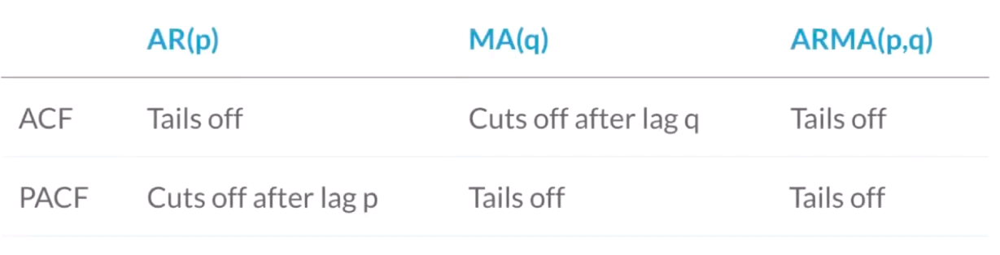



S_PU10
ADF Statistic: 1.079450
p-value: 0.995037
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
---------------------


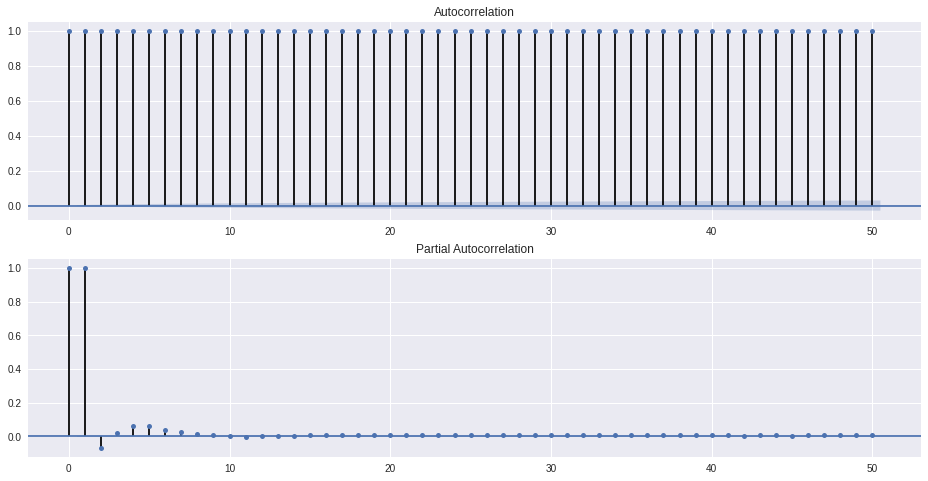

In [ ]:
signal = sensors[4]
Stationarity_ACF(signal)

Observing the ACF plots, we see that PACF cuts off after p lags so we have 2-3 orders and just try 1 of MA just in case apply grid search on that. Also, the test can't reject the null so the series aren't stationary, thus we include 1 order of differencing!

In [ ]:
opt_p, opt_q, AIC = gridSearch(signal= signal, upper_p = 3, upper_q = 1, diff = 1)

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:               453600
Model:                 ARIMA(4, 1, 1)   Log Likelihood              780518.973
Date:                Thu, 27 May 2021   AIC                       -1561025.946
Time:                        21:08:41   BIC                       -1560959.796
Sample:                             0   HQIC                      -1561007.144
                             - 453600                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7638      0.007    103.913      0.000       0.749       0.778
ar.L2         -0.0794      0.002    -41.879      0.000      -0.083      -0.076
ar.L3         -0.0538      0.001    -38.198      0.0

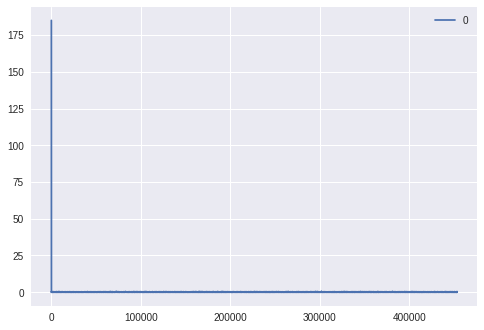

In [ ]:
model, residuals = Model_Residuals(signal, opt_p, opt_q, differencing = 1)

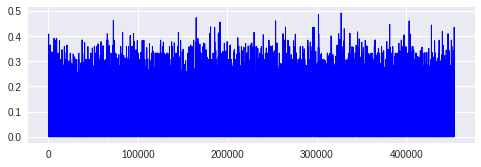

In [ ]:
# Drop first row because is tooo high.
residuals.drop(index=residuals.index[0], 
        axis=0, 
        inplace=True)
fig = plt.figure()
ax = fig.add_subplot(2, 1, 1)

line, = ax.plot(residuals, color='blue', lw=1)

#Residuals errors

I decided to use a grid search approach to decide on how many of the most "wrong" residuals I'll use. Starting from 0.1 to 0.9 with step 0.05.

In [ ]:
ratios = np.arange(0.05, 0.556, 0.05)
max_f1_score = 0
max_ratio = 0
for ratio in ratios:
    clear_output(wait=True)
    threshold = defineThreshold(residuals, ratio=ratio)    
    predicted_values, anomalies_indeces = predict(model, signal, threshold)
   # Aqua is the predicted anomalies
    ground_truth, predicted_anomalies = plotAnomalies(signal, anomalies_indeces)
    # check the funtcions for explaining.
    ground_truth, predicted_anomalies = mapArrays(ground_truth, predicted_anomalies)
    f1_score = calculateCF(ground_truth, predicted_anomalies)
    if (f1_score > max_f1_score):
        max_f1_score = f1_score
        max_ratio = ratio

plot the confusion matrix, and the predictions using the best f1 score achieved with a threshold.

threshold : 0.0008596306469428328


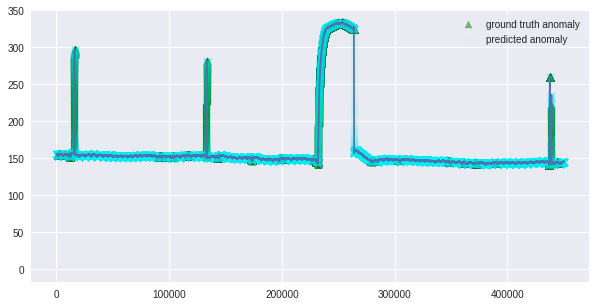

True positives are 28487
True negatives are 174289
False positives are 221730
False negatives are 25413
Recall : 0.5285157699443414
Precision : 0.11384917891270377
f1 score : 0.1873423715214868


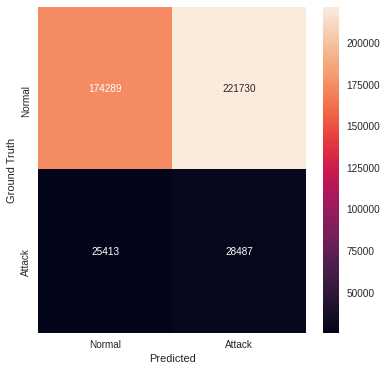

In [ ]:
threshold = defineThreshold(residuals, ratio=max_ratio)    
predicted_values, anomalies_indeces = predict(model, signal, threshold)
# Aqua is the predicted anomalies
ground_truth, predicted_anomalies = plotAnomalies(signal, anomalies_indeces)
# check the funtcions for explaining.
ground_truth, predicted_anomalies = mapArrays(ground_truth, predicted_anomalies)
f1_score = calculateCF(ground_truth, predicted_anomalies)

#SIGNAL PIT502

S_PU10
ADF Statistic: -2.584862
p-value: 0.096167
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
---------------------


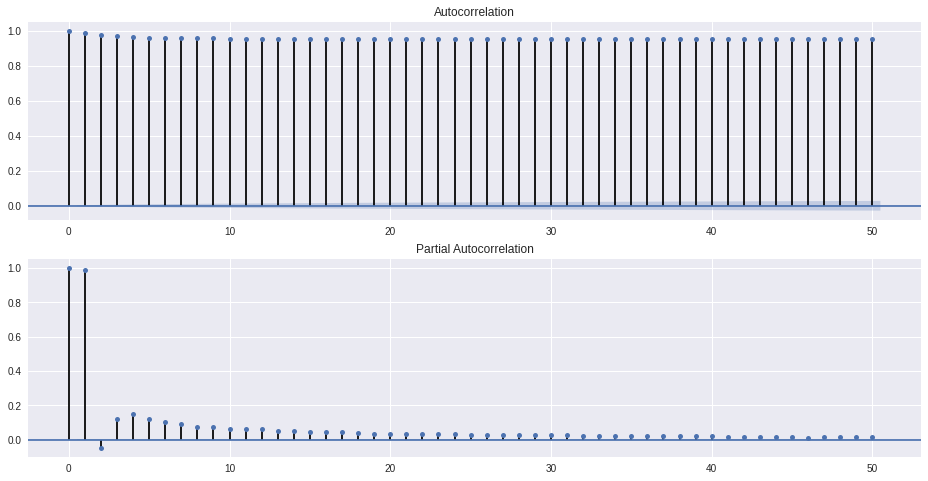

In [ ]:
signal = sensors[0]
Stationarity_ACF(signal)

In [ ]:
opt_p, opt_q, AIC = gridSearch(signal= signal, upper_p = 5, upper_q = 2, diff = 1)

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:568: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)


                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:               453600
Model:                 ARIMA(5, 1, 2)   Log Likelihood             1019237.324
Date:                Thu, 27 May 2021   AIC                       -2038458.649
Time:                        21:23:12   BIC                       -2038370.449
Sample:                             0   HQIC                      -2038433.579
                             - 453600                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0010      0.099      0.010      0.992      -0.194       0.196
ar.L2          0.6688      0.090      7.409      0.000       0.492       0.846
ar.L3         -0.1854      0.015    -12.091      0.0

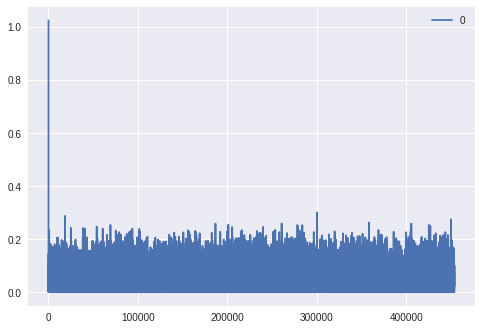

In [ ]:
model, residuals = Model_Residuals(signal, opt_p, opt_q, differencing = 1)

In [ ]:
ratios = np.arange(0.05, 0.556, 0.05)
max_f1_score = 0
max_ratio = 0
for ratio in ratios:
    clear_output(wait=True)
    threshold = defineThreshold(residuals, ratio=ratio)    
    predicted_values, anomalies_indeces = predict(model, signal, threshold)
   # Aqua is the predicted anomalies
    ground_truth, predicted_anomalies = plotAnomalies(signal, anomalies_indeces)
    # check the funtcions for explaining.
    ground_truth, predicted_anomalies = mapArrays(ground_truth, predicted_anomalies)
    f1_score = calculateCF(ground_truth, predicted_anomalies)
    if (f1_score > max_f1_score):
        max_f1_score = f1_score
        max_ratio = ratio

threshold : 0.00430050071266419


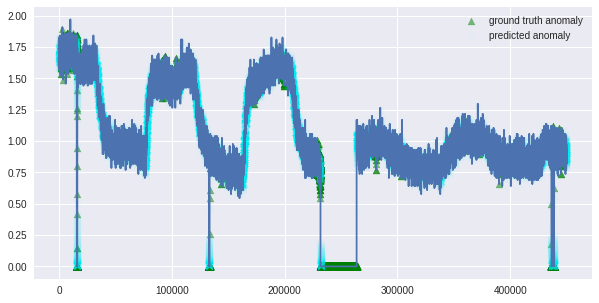

True positives are 10842
True negatives are 212062
False positives are 183957
False negatives are 43058
Recall : 0.20115027829313545
Precision : 0.05565736990436296
f1 score : 0.08718973538293277


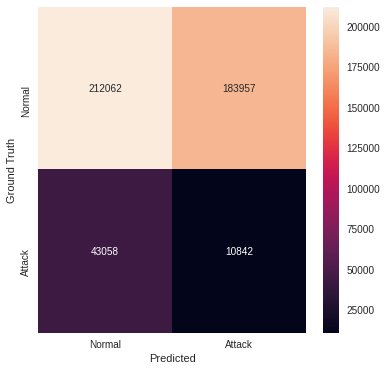

In [ ]:
threshold = defineThreshold(residuals, ratio=max_ratio)    
predicted_values, anomalies_indeces = predict(model, signal, threshold)
# Aqua is the predicted anomalies
ground_truth, predicted_anomalies = plotAnomalies(signal, anomalies_indeces)
# check the funtcions for explaining.
ground_truth, predicted_anomalies = mapArrays(ground_truth, predicted_anomalies)
f1_score = calculateCF(ground_truth, predicted_anomalies)

# Signal LIT301

In [ ]:
signal = sensors[1]

S_PU10
ADF Statistic: -11.070443
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
---------------------


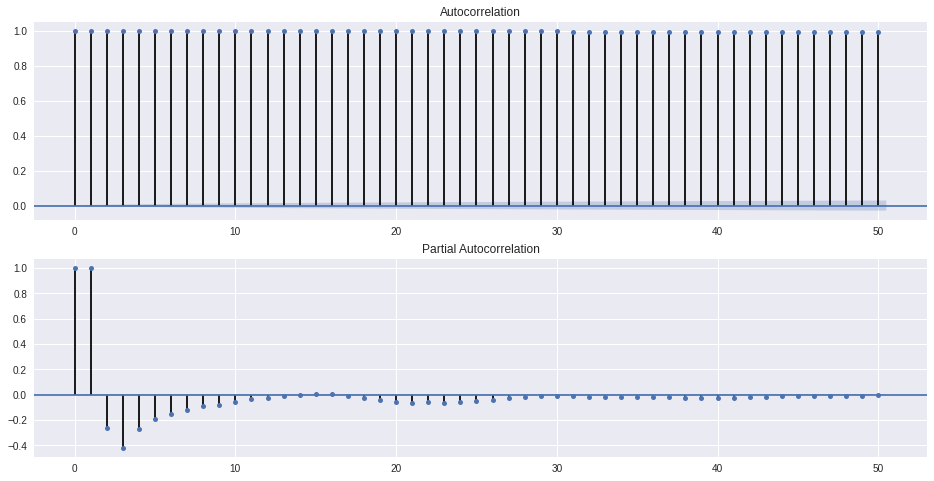

In [ ]:
Stationarity_ACF(signal)

In [ ]:
opt_p, opt_q, AIC = gridSearch(signal= signal, upper_p = 4, upper_q = 1, diff = 0)

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:               453600
Model:                 ARIMA(4, 0, 1)   Log Likelihood              -23805.391
Date:                Thu, 27 May 2021   AIC                          47624.782
Time:                        21:35:59   BIC                          47701.957
Sample:                             0   HQIC                         47646.718
                             - 453600                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        907.6607      2.017    449.945      0.000     903.707     911.615
ar.L1          1.7395      0.002    866.015      0.000       1.736       1.743
ar.L2         -0.4686      0.003   -143.765      0.0

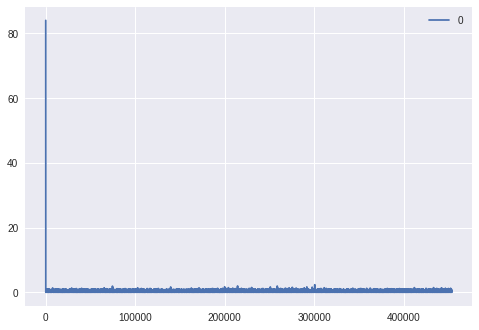

In [ ]:
model, residuals = Model_Residuals(signal, opt_p, opt_q, differencing = 0)

In [ ]:
ratios = np.arange(0.05, 0.556, 0.05)
max_f1_score = 0
max_ratio = 0
for ratio in ratios:
    clear_output(wait=True)
    threshold = defineThreshold(residuals, ratio=ratio)    
    predicted_values, anomalies_indeces = predict(model, signal, threshold)
   # Aqua is the predicted anomalies
    ground_truth, predicted_anomalies = plotAnomalies(signal, anomalies_indeces)
    # check the funtcions for explaining.
    ground_truth, predicted_anomalies = mapArrays(ground_truth, predicted_anomalies)
    f1_score = calculateCF(ground_truth, predicted_anomalies)
    if (f1_score > max_f1_score):
        max_f1_score = f1_score
        max_ratio = ratio

threshold : 0.15055679078216144


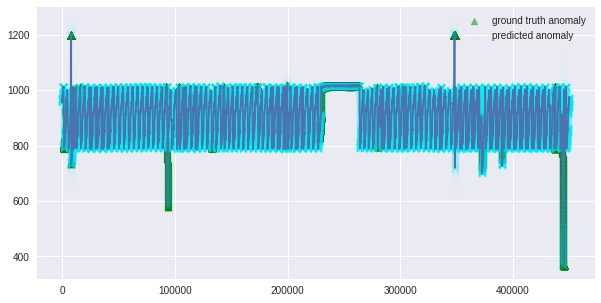

True positives are 27589
True negatives are 176575
False positives are 219444
False negatives are 26311
Recall : 0.5118552875695733
Precision : 0.11168143527382982
f1 score : 0.1833564281750423


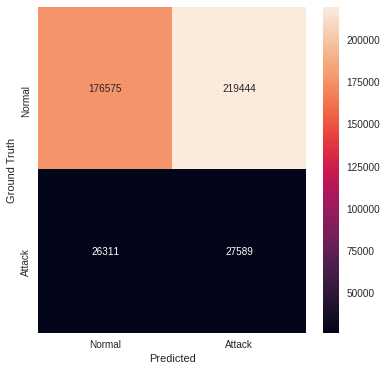

In [ ]:
threshold = defineThreshold(residuals, ratio=max_ratio)    
predicted_values, anomalies_indeces = predict(model, signal, threshold)
# Aqua is the predicted anomalies
ground_truth, predicted_anomalies = plotAnomalies(signal, anomalies_indeces)
# check the funtcions for explaining.
ground_truth, predicted_anomalies = mapArrays(ground_truth, predicted_anomalies)
f1_score = calculateCF(ground_truth, predicted_anomalies)

#SIGNAL MV101

In [ ]:
signal = sensors[2]
Stationarity_ACF(signal) 

In [ ]:
opt_p, opt_q, AIC = gridSearch(signal= signal, upper_p = 5, upper_q = 1, diff = 0)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:               453600
Model:                 ARIMA(4, 0, 1)   Log Likelihood              719336.454
Date:                Thu, 27 May 2021   AIC                       -1438658.908
Time:                        21:45:18   BIC                       -1438581.733
Sample:                             0   HQIC                      -1438636.972
                             - 453600                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.7157      0.053     32.097      0.000       1.611       1.820
ar.L1          0.1007      0.010      9.966      0.000       0.081       0.120
ar.L2          0.8943      0.009     96.648      0.0

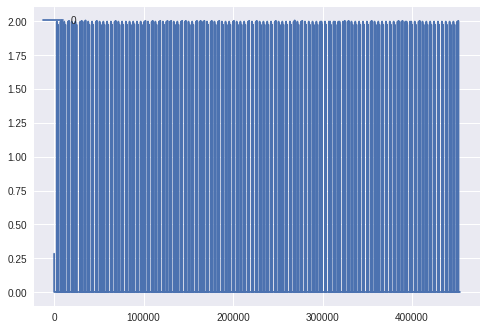

In [ ]:
model, residuals = Model_Residuals(signal, opt_p, opt_q, differencing = 0)

In [ ]:
ratios = np.arange(0.05, 0.556, 0.05)
max_f1_score = 0
max_ratio = 0
for ratio in ratios:
    clear_output(wait=True)
    threshold = defineThreshold(residuals, ratio=ratio)    
    predicted_values, anomalies_indeces = predict(model, signal, threshold)
   # Aqua is the predicted anomalies
    ground_truth, predicted_anomalies = plotAnomalies(signal, anomalies_indeces)
    # check the funtcions for explaining.
    ground_truth, predicted_anomalies = mapArrays(ground_truth, predicted_anomalies)
    f1_score = calculateCF(ground_truth, predicted_anomalies)
    if (f1_score > max_f1_score):
        max_f1_score = f1_score
        max_ratio = ratio

threshold : 0.001598584705789996


/usr/local/lib/python3.7/dist-packages/IPython/core/pylabtools.py:125: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


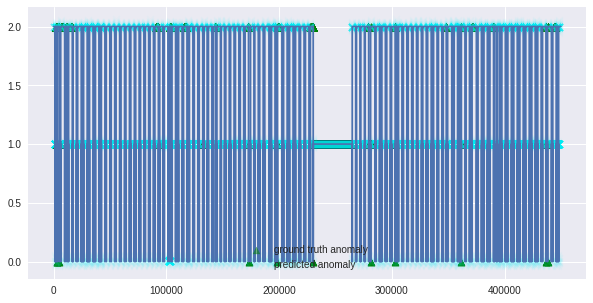

True positives are 38128
True negatives are 276292
False positives are 119727
False negatives are 15772
Recall : 0.7073840445269016
Precision : 0.24153812042697412
f1 score : 0.3601142830157493


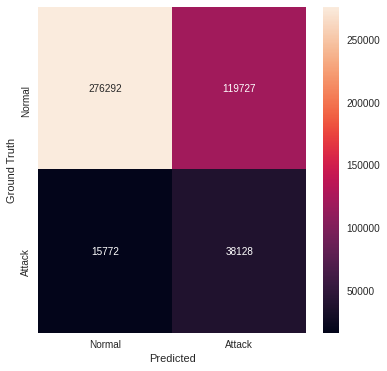

In [ ]:
threshold = defineThreshold(residuals, ratio=max_ratio)    
predicted_values, anomalies_indeces = predict(model, signal, threshold)
# Aqua is the predicted anomalies
ground_truth, predicted_anomalies = plotAnomalies(signal, anomalies_indeces)
# check the funtcions for explaining.
ground_truth, predicted_anomalies = mapArrays(ground_truth, predicted_anomalies)
f1_score = calculateCF(ground_truth, predicted_anomalies)

#SIGNAL FIT501

In [ ]:
signal = sensors[3]
signal

'FIT501'

S_PU10
ADF Statistic: -4.108496
p-value: 0.000938
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
---------------------


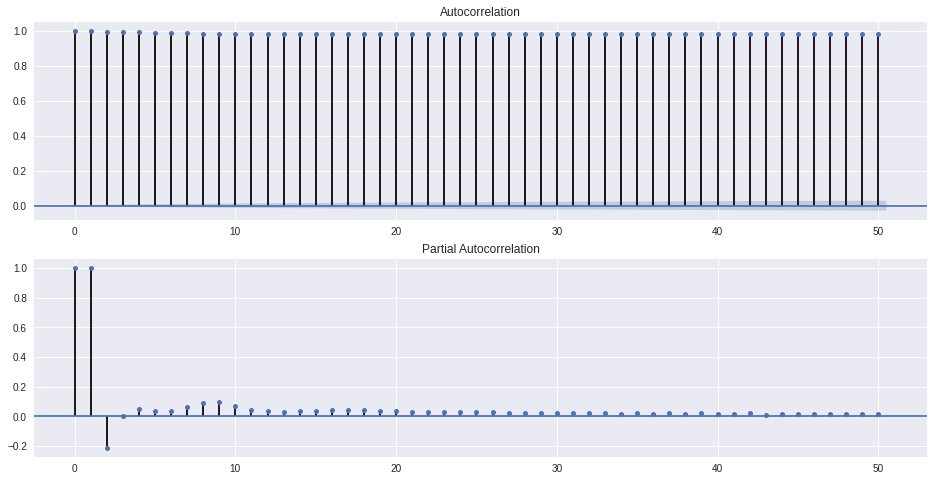

In [ ]:
Stationarity_ACF(signal)

In [ ]:
opt_p, opt_q, AIC = gridSearch(signal= signal, upper_p = 4, upper_q = 1, diff = 0)

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:568: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  ConvergenceWarning)


                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:               453600
Model:                 ARIMA(4, 0, 0)   Log Likelihood             2613631.654
Date:                Thu, 27 May 2021   AIC                       -5227251.309
Time:                        21:50:28   BIC                       -5227185.159
Sample:                             0   HQIC                      -5227232.506
                             - 453600                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.7209      0.001   2860.933      0.000       1.720       1.722
ar.L1          1.2097      0.002    664.812      0.000       1.206       1.213
ar.L2         -0.2032      0.003    -77.059      0.0

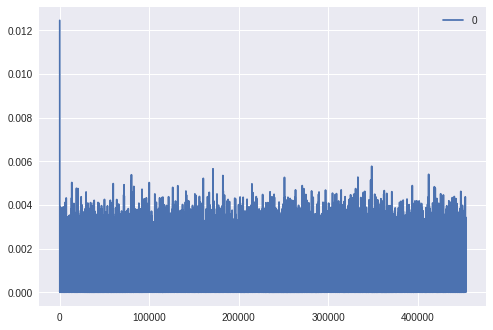

In [ ]:
model, residuals = Model_Residuals(signal, opt_p, opt_q, differencing = 0)

In [ ]:
ratios = np.arange(0.05, 0.556, 0.05)
max_f1_score = 0
max_ratio = 0
for ratio in ratios:
    clear_output(wait=True)
    threshold = defineThreshold(residuals, ratio=ratio)    
    predicted_values, anomalies_indeces = predict(model, signal, threshold)
   # Aqua is the predicted anomalies
    ground_truth, predicted_anomalies = plotAnomalies(signal, anomalies_indeces)
    # check the funtcions for explaining.
    ground_truth, predicted_anomalies = mapArrays(ground_truth, predicted_anomalies)
    f1_score = calculateCF(ground_truth, predicted_anomalies)
    if (f1_score > max_f1_score):
        max_f1_score = f1_score
        max_ratio = ratio

threshold : 0.0019131722158884923


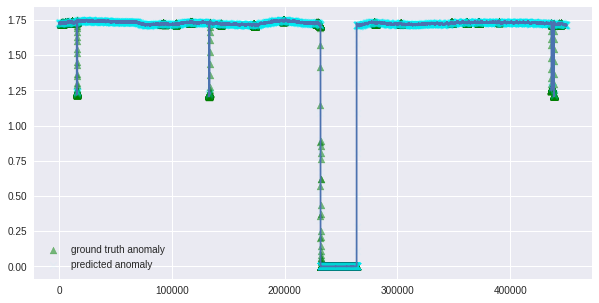

True positives are 33171
True negatives are 377148
False positives are 18871
False negatives are 20729
Recall : 0.615417439703154
Precision : 0.6373890319357443
f1 score : 0.6262105680466671


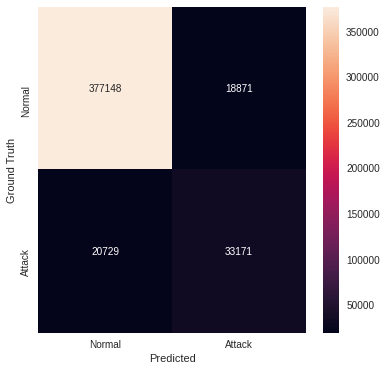

In [ ]:
threshold = defineThreshold(residuals, ratio=max_ratio)    
predicted_values, anomalies_indeces = predict(model, signal, threshold)
# Aqua is the predicted anomalies
ground_truth, predicted_anomalies = plotAnomalies(signal, anomalies_indeces)
# check the funtcions for explaining.
ground_truth, predicted_anomalies = mapArrays(ground_truth, predicted_anomalies)
f1_score = calculateCF(ground_truth, predicted_anomalies)

# Answers to last 2 questions (Whhat kind of anomalies ARMA detects and which sensors models best)

-Plot the residual errors and study some of the detected anomalies. What kind of anomalies can/ canyounotdetect using ARMA models?

ARMA models can detect contextual anomalies. This is because ARMA models regress on previous values and make next step predictions based on them. A high residual means that the data point in question is anamolous in context to the previous values. The model can represent normal behaviour of the system given the previous data points and can detect when the current value deviates. ARMA can also detect point anomalies since the previous values will be too low, so it will predict something similar (even though the next one might be an outlier). Also, this is the reason why ARMA can't detect collective anomalies, since if it predict high values for some points at first, then it will keep predicting high and therefore the residual will be small. 

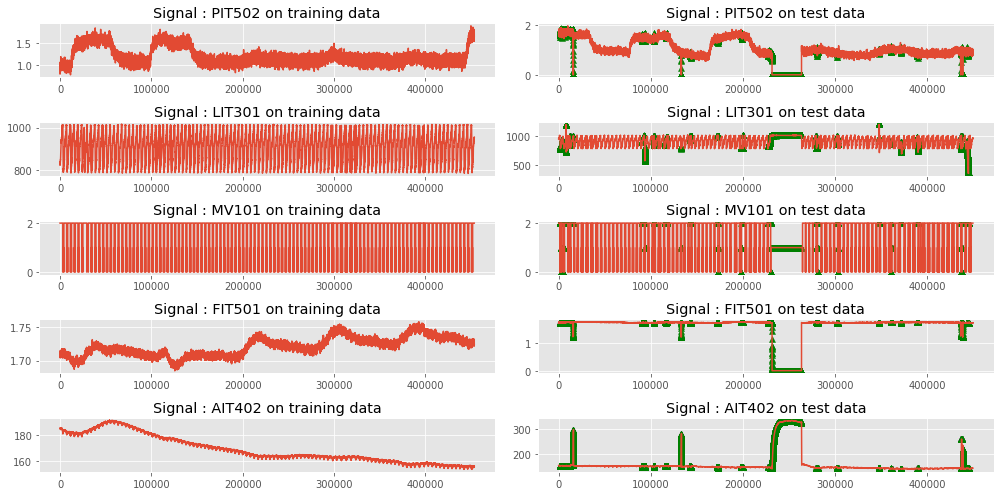

In [6]:
sensors = ['PIT502','LIT301', 'MV101', 'FIT501', 'AIT402']
# plot the train data set.
fig, axs = plt.subplots(5, 2)
fig.set_size_inches((14,7))

df_ARMA = df_test.copy().reset_index(drop=True)
df_train = df.copy().reset_index(drop=True)

for index in range(5):
    df_train[sensors[index]].plot(ax=axs[index, 0])
    axs[index, 0].set_title(f"Signal : {sensors[index]} on training data")
    df_ARMA[sensors[index]].plot(ax=axs[index, 1])
    ground_truth = df_ARMA[sensors[index]][(df_ARMA['Normal/Attack'] == 'Attack')]
    axs[index, 1].scatter(ground_truth.index, ground_truth.values , marker="^", alpha=1, color='green', label="ground truth anomaly")
    axs[index, 1].set_title(f"Signal : {sensors[index]} on test data")

fig.tight_layout()
plt.show()

- Which sensors can be modeled effectively using ARMA?

Based on the above plots, and the corresponding confusion matrices, f1 scores, etc. ARMA can model effectively signals that mostly are linear (e.g. FIT501). When signals start to get complicated (e.g. cyclic behaviour with jumps (PIT502), many upside downs) it starts to become very bad and thus, leading to a terrible F1-Score. Signals that show a clear cyclic behavior (e.g. MV101) are also hard to model because of the many upside downs but the scores aren' the worse either since ARMA have approximatley a 37% F1-Score.